Test out the newly written data_interface modules.

In [1]:
from pathlib import Path

import pandas as pd

from data_interface import data_table


p = Path("/Users/jonathan/0_jono_data")

print(p)

/Users/jonathan/0_jono_data


In [2]:
df = data_table(p)

In [3]:
df = df.sort_values(by = 'acquisition_date', ascending = False)
df.head()

,data,num_detect_files,method,acquisition_date
name,,,,
2021-DEBORTOLI-CABERNET-MERLOT_AVANTOR.D,2023-02-23_2021-DEBORTOLI-CABERNET-MERLOT_AVAN...,7,AVANTOR100X4_6C18-H2O-MEOH-2_1.M,2023-02-23 12:22:35
LOR-RISTRETTO.D,2023-02-23_LOR-RISTRETTO.D: DAD1D.ch - DAD1E.c...,7,AVANTOR100X4_6C18-H2O-MEOH-2_1.M,2023-02-23 11:26:27
2021-DEBORTOLI-CABERNET-MERLOT_HALO.D,2023-02-22_2021-DEBORTOLI-CABERNET-MERLOT_HALO...,7,HALO150X4_6C18-H2O-MEOH-2_1.M,2023-02-22 16:10:39
2021-DEBORTOLI-CABERNET-MERLOT_AVANTOR.D,2023-02-22_2021-DEBORTOLI-CABERNET-MERLOT_AVAN...,7,AVANTOR100X4_6C18-H2O-MEOH-2_1.M,2023-02-22 16:10:39
STONEY-RISE-PN_02-21.D,2023-02-22_STONEY-RISE-PN_02-21.D: DAD1D.ch - ...,7,AVANTOR100X4_6C18-H2O-MEOH-2_1.M,2023-02-22 13:54:34


In [4]:
from data_interface import retrieve_uv_data

data = df.loc['2021-DEBORTOLI-CABERNET-MERLOT_HALO.D']['data']

uv_data = retrieve_uv_data(data)

uv_data.head()

,mins,190,192,194,196,198,200,202,204,206,...,382,384,386,388,390,392,394,396,398,400
0,0.002083,1.356952,0.802681,0.363447,0.064075,-0.108622,-0.213094,-0.276528,-0.306591,-0.314042,...,-0.002004,-0.003204,0.001848,0.004217,0.003152,0.001028,0.004001,0.004686,-0.000417,-0.004716
1,0.008750,1.380287,0.817917,0.372291,0.068411,-0.106871,-0.212140,-0.275753,-0.306018,-0.313409,...,-0.002943,-0.003785,0.002898,0.005551,0.003994,0.000894,0.003889,0.004597,-0.000909,-0.005066
2,0.015417,1.390167,0.824854,0.376731,0.070699,-0.106670,-0.212498,-0.275776,-0.306129,-0.313543,...,-0.004023,-0.005543,0.002809,0.006378,0.004180,0.000335,0.003338,0.004664,-0.000469,-0.004515
3,0.022083,1.384228,0.821218,0.375003,0.069998,-0.108272,-0.214107,-0.276409,-0.306651,-0.314295,...,-0.004478,-0.007145,0.002198,0.006400,0.004038,0.000022,0.002779,0.004582,0.000499,-0.003144
4,0.028750,1.362041,0.806876,0.366777,0.065848,-0.111863,-0.216872,-0.277452,-0.307329,-0.315309,...,-0.004515,-0.008509,0.001185,0.005625,0.003844,0.000775,0.002876,0.004128,0.001498,-0.001200


It would be useful to drop unwanted or unpopulated wavelengths. Since wavelengths are stored column by column, to drop a range we'd need to convert to a long format then institute a logical mask, then swap back to wide.

In [5]:
from hplc_dad_plots import plot_3d

uv_data_melt = uv_data.melt(id_vars = 'mins')

uv_data_melt.columns = ['mins', 'nm', 'mAU']

uv_data_melt = uv_data_melt[(uv_data_melt['nm'] > 210) & (uv_data_melt['nm'] < 255)]

uv_data_211 = uv_data_melt.pivot(columns = ['nm'], index = 'mins', values = 'mAU')

uv_data_211 = uv_data_211.reset_index(names = 'mins')

uv_data_211

nm,mins,212,214,216,218,220,222,224,226,228,...,236,238,240,242,244,246,248,250,252,254
0,0.002083,-0.226170,-0.198953,-0.172906,-0.151150,-0.127003,-0.099063,-0.065781,-0.041679,-0.025786,...,-0.002481,-0.000313,-0.000052,-0.004955,-0.011720,-0.014089,-0.015229,-0.014991,-0.013284,-0.014104
1,0.008750,-0.226989,-0.199392,-0.173815,-0.151902,-0.127479,-0.099778,-0.066862,-0.042632,-0.026561,...,-0.002615,-0.000484,-0.000775,-0.005707,-0.011861,-0.013731,-0.015229,-0.015184,-0.013277,-0.014015
2,0.015417,-0.228412,-0.200413,-0.174895,-0.152633,-0.127919,-0.100195,-0.067778,-0.043593,-0.027269,...,-0.002883,-0.000827,-0.001550,-0.006497,-0.011936,-0.013389,-0.015385,-0.015520,-0.013471,-0.013992
3,0.022083,-0.230037,-0.201754,-0.176027,-0.152938,-0.127926,-0.100248,-0.068426,-0.044234,-0.027716,...,-0.003077,-0.001162,-0.002086,-0.006914,-0.011675,-0.012986,-0.015587,-0.015691,-0.013582,-0.013895
4,0.028750,-0.231698,-0.203274,-0.177078,-0.152692,-0.127487,-0.100300,-0.068948,-0.044659,-0.027999,...,-0.003099,-0.001520,-0.002436,-0.006907,-0.011012,-0.012368,-0.015594,-0.015765,-0.013702,-0.013657
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7742,51.615417,-5.060010,-4.546210,-4.025057,-3.554963,-3.142849,-2.773188,-2.460711,-2.189435,-1.961164,...,-1.436621,-1.395740,-1.374446,-1.368515,-1.371890,-1.383968,-1.395166,-1.397960,-1.392156,-1.378715
7743,51.622083,-5.058914,-4.546039,-4.025444,-3.554799,-3.142774,-2.773933,-2.461456,-2.189785,-1.961231,...,-1.437552,-1.396485,-1.375332,-1.369201,-1.372144,-1.384333,-1.395576,-1.398481,-1.392864,-1.379445
7744,51.628750,-5.058691,-4.546113,-4.026085,-3.554858,-3.142640,-2.774522,-2.462387,-2.190590,-1.961663,...,-1.438528,-1.397073,-1.376085,-1.369677,-1.372345,-1.384705,-1.396015,-1.399197,-1.393683,-1.380049
7745,51.635417,-5.059190,-4.546478,-4.026733,-3.554925,-3.142320,-2.774782,-2.463244,-2.191603,-1.962371,...,-1.439340,-1.397438,-1.376525,-1.369998,-1.372874,-1.385301,-1.396440,-1.399957,-1.394480,-1.380578


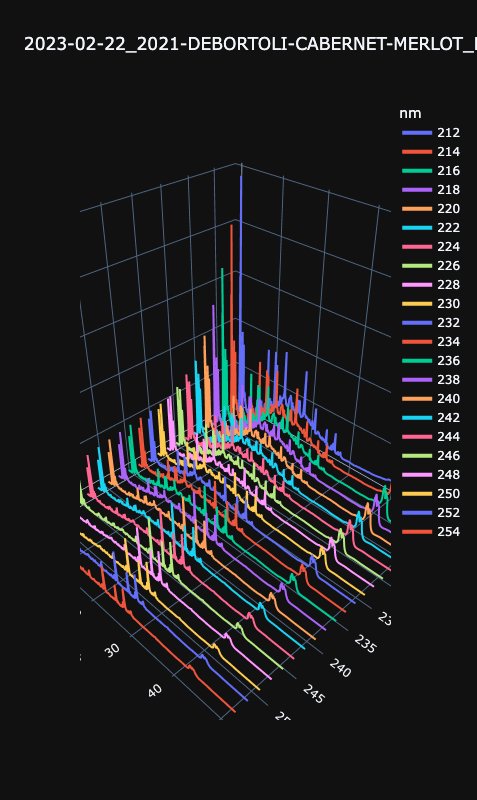

In [6]:
plot_3d(uv_data_211, plot_title = data.name)

We're looking like we've got a good interface going now. next step will be to:

- Integrate sequences into the table.
- Get a dashboard going with Panel.
- Get some descriptive measurements going through scipy.
- get some statistical data going.

In [7]:

import plotly.graph_objects as go

import numpy as np

uv_data_211 = uv_data_211.iloc[::10, :]

uv_data_211.shape

surf_data = uv_data_211.melt(id_vars = 'mins')

surf_data.columns

# mesh_data = np.meshgrid(x,y)

# X, Y = mesh_data

# surface = go.Surface(x = X, y = Y, z = Z)

# fig = go.Figure([surface])

# fig.show()

Index(['mins', 'nm', 'value'], dtype='object')

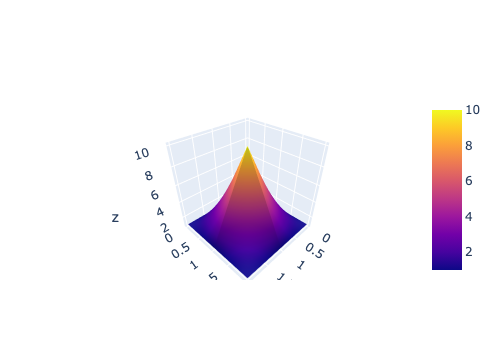

In [8]:
# Finally, a fucking working surface plot.

import plotly.graph_objects as go
p = go.Figure()
p.add_trace(go.Surface(
    x = [0,1,2],
    y = [0,1,2],
    z = [[1,1,1],[1,10,1],[1,1,1]]
))
p.show()

In [9]:
Z = np.linspace(1,1, 9)
Z = Z.reshape(3,3)
Z[1][1] = 20

In [10]:
# Finally, a fucking working surface plot.

import plotly.graph_objects as go
p = go.Figure()
p.add_trace(go.Surface(
    z = Z
))
p.show()

SyntaxError: invalid syntax (675845080.py, line 8)

[python - Reshape arbitrary length vector into square matrix with padding in numpy - Stack Overflow](https://stackoverflow.com/questions/41176248/reshape-arbitrary-length-vector-into-square-matrix-with-padding-in-numpy)

Need a dataset that is square.

The full dataset is too large to plot in 3d. One approach could be to 'downsample, or use plotly's 'extend_traces' method.